## <center>**Building Flight Price Prediction.**</center>

### **Importing Libraries**

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

### **Data Source : `KAGGLE`** - `(Machine Hack)`
**Link:** https://www.kaggle.com/datasets/nikhilmittal/flight-fare-prediction-mh/data

In [2]:
df = pd.read_excel("datasets/Data_Train.xlsx")

In [3]:
df.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10683 non-null  object
 1   Date_of_Journey  10683 non-null  object
 2   Source           10683 non-null  object
 3   Destination      10683 non-null  object
 4   Route            10682 non-null  object
 5   Dep_Time         10683 non-null  object
 6   Arrival_Time     10683 non-null  object
 7   Duration         10683 non-null  object
 8   Total_Stops      10682 non-null  object
 9   Additional_Info  10683 non-null  object
 10  Price            10683 non-null  int64 
dtypes: int64(1), object(10)
memory usage: 918.2+ KB


In [5]:
df.describe()

,Price
count,10683.000000
mean,9087.064121
std,4611.359167
min,1759.000000
25%,5277.000000
50%,8372.000000
75%,12373.000000
max,79512.000000


In [6]:
df.dtypes

Airline            object
Date_of_Journey    object
Source             object
Destination        object
Route              object
Dep_Time           object
Arrival_Time       object
Duration           object
Total_Stops        object
Additional_Info    object
Price               int64
dtype: object

</br>

### **Feature Engineering**

#### a. **Handling `Missing Values`**

In [7]:
df.isna().sum()

Airline            0
Date_of_Journey    0
Source             0
Destination        0
Route              1
Dep_Time           0
Arrival_Time       0
Duration           0
Total_Stops        1
Additional_Info    0
Price              0
dtype: int64

**Remove the NaN values from the dataset.**

In [8]:
df.dropna(how='any',inplace=True)
df.isnull().sum()

Airline            0
Date_of_Journey    0
Source             0
Destination        0
Route              0
Dep_Time           0
Arrival_Time       0
Duration           0
Total_Stops        0
Additional_Info    0
Price              0
dtype: int64

In [9]:
df.Source.unique()

array(['Banglore', 'Kolkata', 'Delhi', 'Chennai', 'Mumbai'], dtype=object)

In [10]:
df.Destination.unique()

array(['New Delhi', 'Banglore', 'Cochin', 'Kolkata', 'Delhi', 'Hyderabad'],
      dtype=object)

#### b. **Handling special instance.**

Replacing **"New Delhi"** by **"Delhi"** in the entire dataset, in order to prevent confusion.

In [11]:
df['Source'].unique()

array(['Banglore', 'Kolkata', 'Delhi', 'Chennai', 'Mumbai'], dtype=object)

In [12]:
df["Destination"].unique()

array(['New Delhi', 'Banglore', 'Cochin', 'Kolkata', 'Delhi', 'Hyderabad'],
      dtype=object)

In [13]:
for i in df:
    df.replace("New Delhi", "Delhi", inplace=True)

In [14]:
df["Destination"].unique()

array(['Delhi', 'Banglore', 'Cochin', 'Kolkata', 'Hyderabad'],
      dtype=object)

#### c. **Handling `time` related features / columns.**

#### 1. *Date of Journey*

Let's convert **"Date_of_Journey"** to its appropriate format as **`datetime`** with regards to **`day`** and **`month`**.

In [15]:
df[['Date_of_Journey']]

,Date_of_Journey
0,24/03/2019
1,1/05/2019
2,9/06/2019
3,12/05/2019
4,01/03/2019
...,...
10678,9/04/2019
10679,27/04/2019
10680,27/04/2019
10681,01/03/2019


In [16]:
df['Date_of_Journey'] = pd.to_datetime(df['Date_of_Journey'])
df['Day_of_Journey'] = (df['Date_of_Journey']).dt.day
df['Month_of_Journey'] = (df['Date_of_Journey']).dt.month

In [17]:
df[["Date_of_Journey", "Day_of_Journey", "Month_of_Journey"]]

,Date_of_Journey,Day_of_Journey,Month_of_Journey
0,2019-03-24,24,3
1,2019-01-05,5,1
2,2019-09-06,6,9
3,2019-12-05,5,12
4,2019-01-03,3,1
...,...,...,...
10678,2019-09-04,4,9
10679,2019-04-27,27,4
10680,2019-04-27,27,4
10681,2019-01-03,3,1


Drop the **"Date_of_journey"** column. 

In [18]:
df.drop(["Date_of_Journey"], axis=1, inplace=True)

Let's do the same for the other **relative columns**.

#### 2. *Dep_time*

Extracting and storing the hour & minute component of 'Dep_Time'.

In [19]:
df['Dep_hr'] = pd.to_datetime(df['Dep_Time']).dt.hour
df['Dep_min'] = pd.to_datetime(df['Dep_Time']).dt.minute

In [20]:
df.drop(["Dep_Time"], axis=1, inplace=True)

#### 3. *Arrival Time*

Extracting and storing the hour & minute component of 'Dep_Time'.

In [21]:
df['Arrival_hr']=pd.to_datetime(df['Arrival_Time']).dt.hour
df['Arrival_min']=pd.to_datetime(df['Arrival_Time']).dt.minute

In [22]:
df.drop(["Arrival_Time"],axis=1,inplace=True)

#### 4. *Duration*

In [23]:
df[['Duration']]

,Duration
0,2h 50m
1,7h 25m
2,19h
3,5h 25m
4,4h 45m
...,...
10678,2h 30m
10679,2h 35m
10680,3h
10681,2h 40m


Split `'Duration'` into hours and minutes using space as a delimiter.

In [24]:
duration = df['Duration'].str.split(' ',expand=True)

Fill missing values in the minutes column with **'00m'**.

In [25]:
duration[1].fillna('00m',inplace=True)

Create `'duration_hr'` & `'duration_min'`: Extract **hours & minutes** by removing the last character **('h' / 'm')**.

In [26]:
df['duration_hr'] = duration[0].apply(lambda x: x[:-1])
df['duration_min'] = duration[1].apply(lambda x: x[:-1]) 

In [27]:
df.drop(["Duration"],axis=1,inplace=True)

</br>

### **EDA (Exploratory Data Analysis)**

#### **Analysing `Airline`.**

In [28]:
df['Airline'].value_counts()

Jet Airways                          3849
IndiGo                               2053
Air India                            1751
Multiple carriers                    1196
SpiceJet                              818
Vistara                               479
Air Asia                              319
GoAir                                 194
Multiple carriers Premium economy      13
Jet Airways Business                    6
Vistara Premium economy                 3
Trujet                                  1
Name: Airline, dtype: int64

**`Airline` v/ `Price`**

In [29]:
airline_prices = df.groupby('Airline')['Price'].mean().sort_values(ascending=False)
airline_prices

Airline
Jet Airways Business                 58358.666667
Jet Airways                          11643.923357
Multiple carriers Premium economy    11418.846154
Multiple carriers                    10902.678094
Air India                             9612.427756
Vistara Premium economy               8962.333333
Vistara                               7796.348643
GoAir                                 5861.056701
IndiGo                                5673.682903
Air Asia                              5590.260188
SpiceJet                              4338.284841
Trujet                                4140.000000
Name: Price, dtype: float64

c:\Users\faizan\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


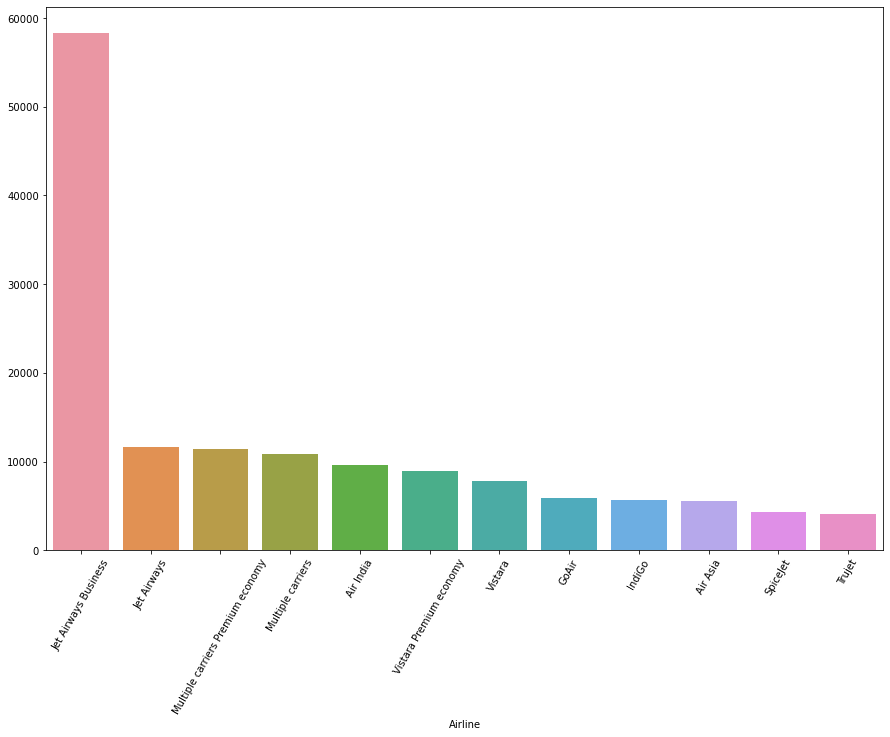

In [30]:
plt.figure(figsize=(15,10))
sns.barplot(airline_prices.index, airline_prices.values)
plt.xticks(rotation=60)
plt.show()

`Jet Airways Business` has the *highest* price with `Trujet` having the *lowest*.

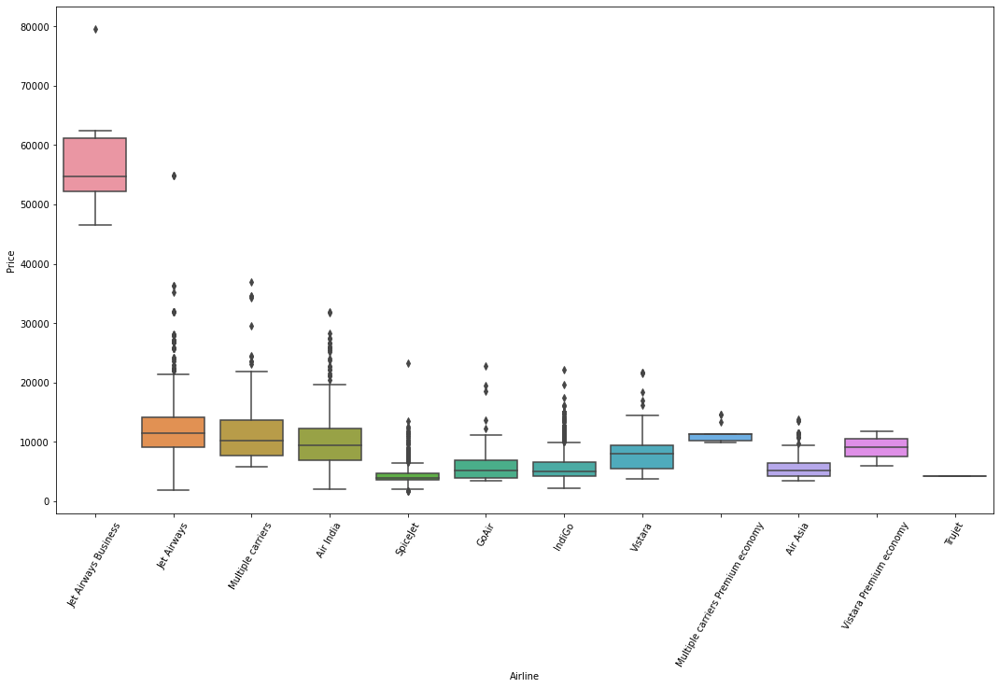

In [31]:
plt.figure(figsize=(18,10))
sns.boxplot(y='Price',x='Airline',data= df.sort_values('Price',ascending=False))
plt.xticks(rotation=60)
plt.show()

#### **Analysing `Price`**

**Price based on number of stops.**

In [32]:
df.groupby(['Airline','Total_Stops'])['Price'].mean()

Airline                            Total_Stops
Air Asia                           1 stop          7078.325581
                                   2 stops         6341.888889
                                   non-stop        4492.331492
Air India                          1 stop          9041.509259
                                   2 stops        12092.779101
                                   3 stops        12208.054054
                                   4 stops        17686.000000
                                   non-stop        5605.326139
GoAir                              1 stop          6884.676471
                                   non-stop        4726.173913
IndiGo                             1 stop          7104.717528
                                   2 stops         7507.526316
                                   non-stop        4731.174053
Jet Airways                        1 stop         12512.741223
                                   2 stops        13387.247467
        

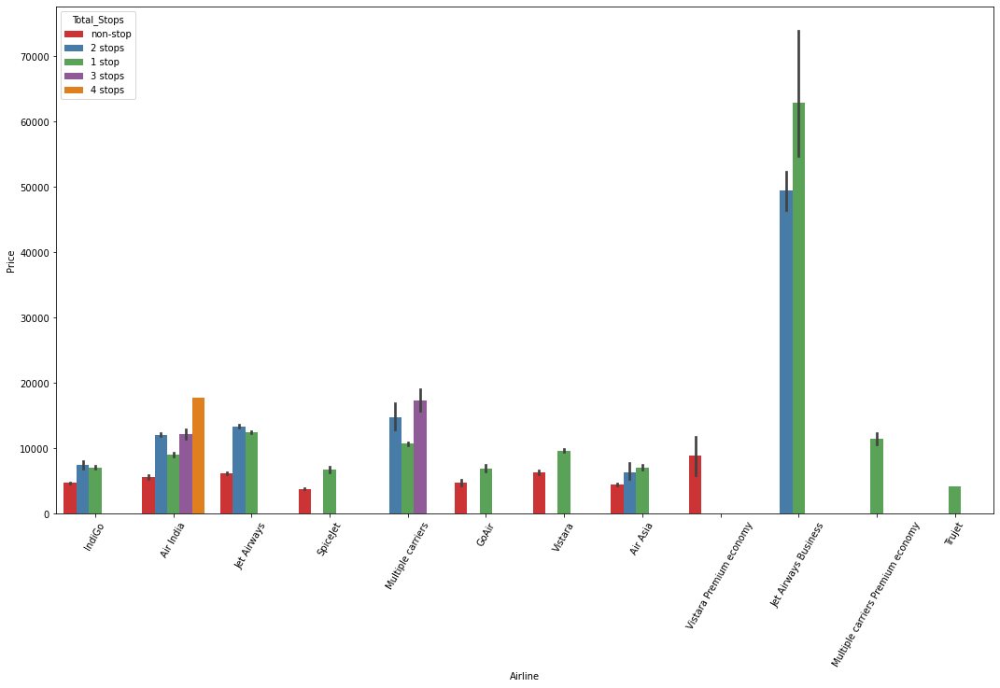

In [33]:
plt.figure(figsize=(18,10))
ax=sns.barplot(x=df['Airline'], y=df['Price'], hue=df['Total_Stops'], palette="Set1")
ax.set_xticklabels(ax.get_xticklabels(), rotation=60)
plt.show()

**One stop and two stops with `Jet Airways Business` consists of the highest prices among all other flights-stops combination.**

#### **Analysing `Source`**

In [34]:
df['Source'].value_counts()

Delhi       4536
Kolkata     2871
Banglore    2197
Mumbai       697
Chennai      381
Name: Source, dtype: int64

**`Source` v/ `Price`**

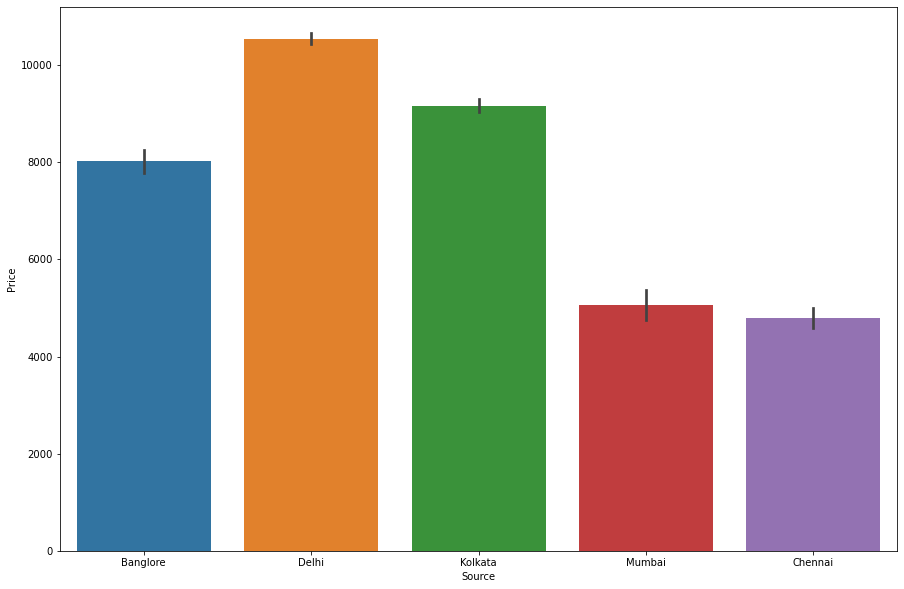

In [35]:
plt.figure(figsize=(15,10))
sns.barplot(y='Price', x='Source', data=df.sort_values('Price', ascending=False))
plt.show() 

#### **Analysing `Destination`**

In [36]:
df["Destination"].unique()

array(['Delhi', 'Banglore', 'Cochin', 'Kolkata', 'Hyderabad'],
      dtype=object)

In [37]:
df["Destination"].value_counts()

Cochin       4536
Banglore     2871
Delhi        2197
Hyderabad     697
Kolkata       381
Name: Destination, dtype: int64

**`Destination` v/ `Price`**

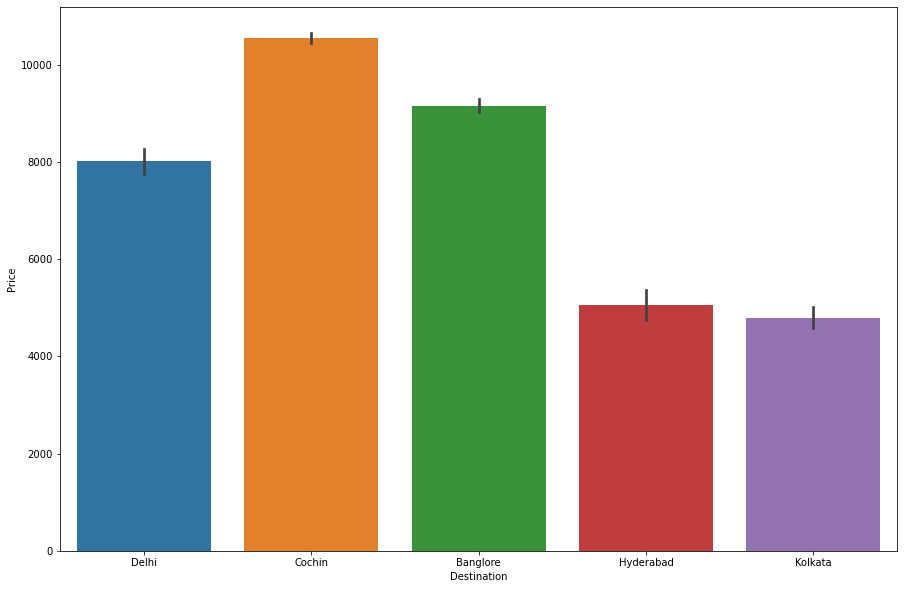

In [38]:
plt.figure(figsize=(15,10))
sns.barplot(y='Price', x='Destination', data=df.sort_values('Price',ascending=False))
plt.show()

#### **Analysing `Correlation.`**

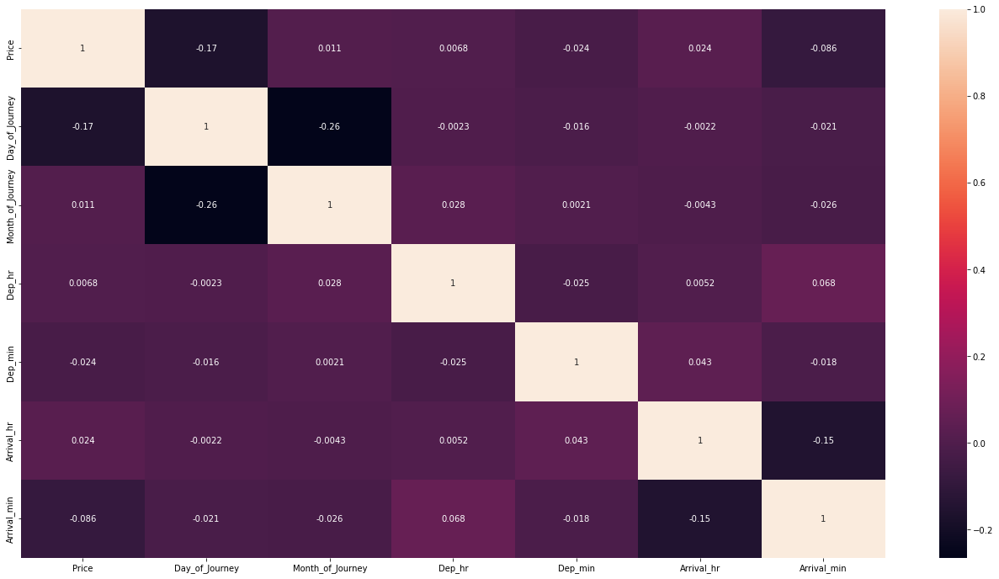

In [39]:
plt.figure(figsize=(23,12))
sns.heatmap(df.corr(), annot=True)
plt.show()

**The features are less correlated which is a good thing for us to avoid `Multicollinearity`.**

### **Handling Categorical Variables.**

**Apply `One-Hot Encoding`.**

In [40]:
df['Total_Stops'] = df['Total_Stops'].map({'non-stop':0, '2 stops':2, '1 stop':1, '3 stops':3, '4 stops':4})

In [41]:
dummy_airline = pd.get_dummies(df["Airline"], drop_first=True)
dummy_src_dest = pd.get_dummies(df[["Source", "Destination"]], drop_first=True)

In [42]:
df = pd.concat([dummy_airline, dummy_src_dest, df], axis=1)

In [43]:
df.drop(['Airline','Source','Destination'], inplace=True, axis=1)

In [44]:
df.head()

,Air India,GoAir,IndiGo,Jet Airways,Jet Airways Business,Multiple carriers,Multiple carriers Premium economy,SpiceJet,Trujet,Vistara,...,Additional_Info,Price,Day_of_Journey,Month_of_Journey,Dep_hr,Dep_min,Arrival_hr,Arrival_min,duration_hr,duration_min
0,0,0,1,0,0,0,0,0,0,0,...,No info,3897,24,3,22,20,1,10,2,50
1,1,0,0,0,0,0,0,0,0,0,...,No info,7662,5,1,5,50,13,15,7,25
2,0,0,0,1,0,0,0,0,0,0,...,No info,13882,6,9,9,25,4,25,19,00
3,0,0,1,0,0,0,0,0,0,0,...,No info,6218,5,12,18,5,23,30,5,25
4,0,0,1,0,0,0,0,0,0,0,...,No info,13302,3,1,16,50,21,35,4,45


### **Handling Test Data.**

In [45]:
df_test = pd.read_excel("datasets/Test_set.xlsx")

In [46]:
df_test.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info
0,Jet Airways,6/06/2019,Delhi,Cochin,DEL → BOM → COK,17:30,04:25 07 Jun,10h 55m,1 stop,No info
1,IndiGo,12/05/2019,Kolkata,Banglore,CCU → MAA → BLR,06:20,10:20,4h,1 stop,No info
2,Jet Airways,21/05/2019,Delhi,Cochin,DEL → BOM → COK,19:15,19:00 22 May,23h 45m,1 stop,In-flight meal not included
3,Multiple carriers,21/05/2019,Delhi,Cochin,DEL → BOM → COK,08:00,21:00,13h,1 stop,No info
4,Air Asia,24/06/2019,Banglore,Delhi,BLR → DEL,23:55,02:45 25 Jun,2h 50m,non-stop,No info


In [47]:
df_test.shape

(2671, 10)

**Performing all the same steps as we did for train data earlier.**

Handling `special instance` (replacing "New Delhi" to "Delhi").

In [48]:
for i in df_test:
    df_test.replace("New Delhi", "Delhi", inplace=True)

Handling `time` features / columns.

In [49]:
# Date of Journey

df_test['Date_of_Journey'] = pd.to_datetime(df_test['Date_of_Journey'])
df_test['Day_of_Journey'] = (df_test['Date_of_Journey']).dt.day
df_test['Month_of_Journey'] = (df_test['Date_of_Journey']).dt.month


# Dep_time 

df_test['Dep_hr'] = pd.to_datetime(df_test['Dep_Time']).dt.hour
df_test['Dep_min'] = pd.to_datetime(df_test['Dep_Time']).dt.minute

# Arrival_time

df_test['Arrival_hr'] = pd.to_datetime(df_test['Arrival_Time']).dt.hour
df_test['Arrival_min'] = pd.to_datetime(df_test['Arrival_Time']).dt.minute

# Duration

a = df_test['Duration'].str.split(' ',expand=True)
a[1].fillna('00m',inplace=True)

df_test['dur_hr'] = a[0].apply(lambda x: x[:-1])
df_test['dur_min'] = a[1].apply(lambda x: x[:-1])

# Dropping columns.
df_test.drop(['Date_of_Journey','Duration','Arrival_Time','Dep_Time'], inplace=True, axis=1)

Handling Categorical Values.

In [50]:
df_test['Total_Stops'] = df_test['Total_Stops'].map({'non-stop':0, '2 stops':2, '1 stop':1, '3 stops':3, '4 stops':4})

air_dummy = pd.get_dummies(df_test['Airline'],drop_first=True)

source_dest_dummy = pd.get_dummies(df_test[['Source','Destination']],drop_first=True)

df_test = pd.concat([air_dummy,source_dest_dummy,df_test],axis=1)

Dropping unnecessary columns.

In [51]:
df_test.drop(['Airline','Source','Destination','Additional_Info',"Route"], inplace=True, axis=1)

In [52]:
df_test.columns

Index(['Air India', 'GoAir', 'IndiGo', 'Jet Airways', 'Jet Airways Business',
       'Multiple carriers', 'Multiple carriers Premium economy', 'SpiceJet',
       'Vistara', 'Vistara Premium economy', 'Source_Chennai', 'Source_Delhi',
       'Source_Kolkata', 'Source_Mumbai', 'Destination_Cochin',
       'Destination_Delhi', 'Destination_Hyderabad', 'Destination_Kolkata',
       'Total_Stops', 'Day_of_Journey', 'Month_of_Journey', 'Dep_hr',
       'Dep_min', 'Arrival_hr', 'Arrival_min', 'dur_hr', 'dur_min'],
      dtype='object')

Analysing dataset shapes after performing all the operations. 

In [53]:
print(f"Train dataset shape : {df.shape}")
print(f"Test dataset shape : {df_test.shape}")

Train dataset shape : (10682, 31)
Test dataset shape : (2671, 27)


### **Feature Selection**

In [54]:
X = df.drop(['Route', 'Price','Additional_Info'], axis=1)
y = df['Price']

In [55]:
X.shape, y.shape

((10682, 28), (10682,))

In [56]:
X.columns

Index(['Air India', 'GoAir', 'IndiGo', 'Jet Airways', 'Jet Airways Business',
       'Multiple carriers', 'Multiple carriers Premium economy', 'SpiceJet',
       'Trujet', 'Vistara', 'Vistara Premium economy', 'Source_Chennai',
       'Source_Delhi', 'Source_Kolkata', 'Source_Mumbai', 'Destination_Cochin',
       'Destination_Delhi', 'Destination_Hyderabad', 'Destination_Kolkata',
       'Total_Stops', 'Day_of_Journey', 'Month_of_Journey', 'Dep_hr',
       'Dep_min', 'Arrival_hr', 'Arrival_min', 'duration_hr', 'duration_min'],
      dtype='object')

#### **Train Test Split**

In [57]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=50)

## <center>**Model Building and Hyperparameter Tuning**</center>

In [58]:
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import RandomForestRegressor

from catboost import CatBoostRegressor, Pool
from lightgbm import LGBMRegressor

import xgboost as xgb

# --------------------

from sklearn.model_selection import RandomizedSearchCV, GridSearchCV

from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error, mean_squared_error

### I. **Extra Trees Regressor**

In [59]:
et_model = ExtraTreesRegressor()
et_model.fit(X, y)

ExtraTreesRegressor()

**Feature Importance**

<AxesSubplot:>

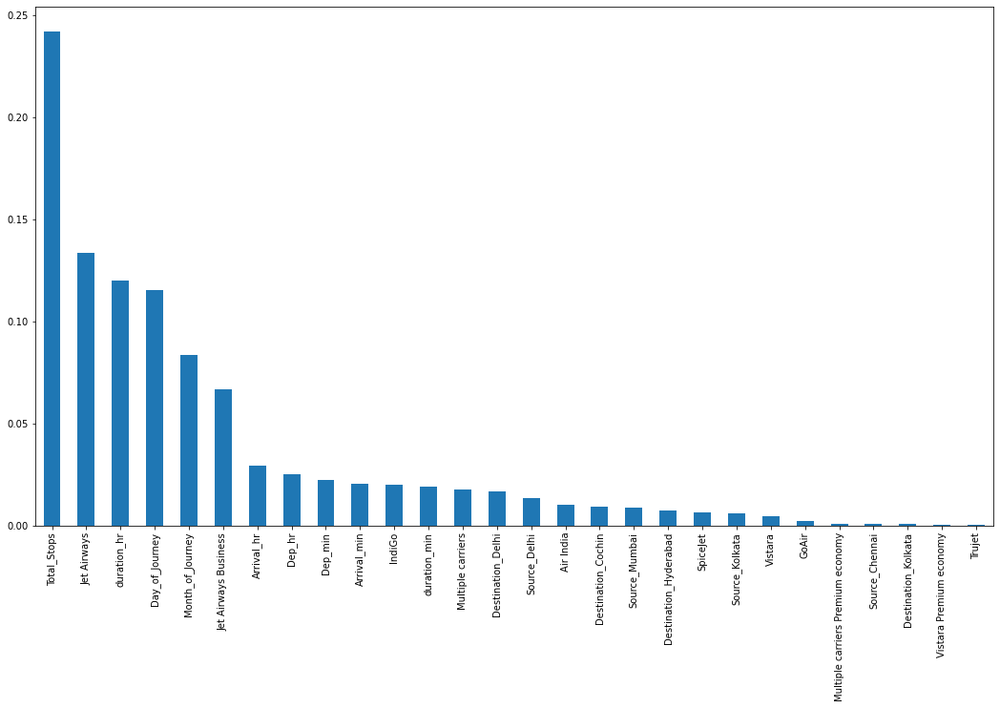

In [60]:
pd.Series(et_model.feature_importances_, index=X.columns).sort_values(ascending=False).plot(kind='bar',figsize=(18,10))

Now training Extra Trees Regressor using *X_train & y_train*.

In [61]:
et_model = ExtraTreesRegressor(n_estimators = 120)
et_model.fit(X_train,y_train)

ExtraTreesRegressor(n_estimators=120)

In [62]:
et_pred = et_model.predict(X_test)
et_pred

array([10844.        ,  4138.18333333,  6246.5       , ...,
       10806.1125    , 10772.46666667,  8299.50833333])

In [63]:
r2_score(y_test, et_pred)

0.7670724822552857

### II. **Random Forest Regressor**

In [64]:
rf_model = RandomForestRegressor()
rf_model.fit(X_train,y_train)

RandomForestRegressor()

In [65]:
rf_pred = rf_model.predict(X_test)

In [66]:
r2_score(y_test, rf_pred)

0.7932216417930269

**`RF` - Hyperparameter Tuning**

In [67]:
n_estimators = [int(x) for x in np.linspace(start = 80, stop = 1500, num = 10)]

max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(6, 45, num = 5)]

min_samples_split = [2, 5, 10, 15, 100]
min_samples_leaf = [1, 2, 5, 10]

In [68]:
rscv_grid={'n_estimators': n_estimators,
            'max_features': max_features,
            'max_depth': max_depth,
            'min_samples_split': min_samples_split,
            'min_samples_leaf': min_samples_leaf}

In [69]:
rf = RandomForestRegressor()

rf_rs_CV = RandomizedSearchCV(
    estimator = rf,
    param_distributions = rscv_grid,
    scoring = 'neg_mean_squared_error',
    n_iter=10, cv=3,
    random_state=42, 
    n_jobs = 1
)

In [70]:
rf_rs_CV.fit(X_train,y_train)

RandomizedSearchCV(cv=3, estimator=RandomForestRegressor(), n_jobs=1,
                   param_distributions={'max_depth': [6, 15, 25, 35, 45],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 5, 10],
                                        'min_samples_split': [2, 5, 10, 15,
                                                              100],
                                        'n_estimators': [80, 237, 395, 553, 711,
                                                         868, 1026, 1184, 1342,
                                                         1500]},
                   random_state=42, scoring='neg_mean_squared_error')

In [71]:
rf_rscv_pred = rf_rs_CV.predict(X_test)
r2_score(y_test, rf_rscv_pred)

0.8067965493535422

In [72]:
print(f"MAE : {mean_absolute_error(y_test, rf_rscv_pred)}")
print(f"MSE : {mean_squared_error(y_test, rf_rscv_pred)}")

MAE : 1157.1583726217452
MSE : 3967176.9477029275


### III. **Catboost Regressor**

In [73]:
cat_model = CatBoostRegressor()
cat_model.fit(X_train,y_train)

Learning rate set to 0.057463


0:	learn: 4465.7280757	total: 113ms	remaining: 1m 52s
1:	learn: 4317.7245126	total: 117ms	remaining: 58.2s
2:	learn: 4167.9871081	total: 120ms	remaining: 39.7s
3:	learn: 4030.4839609	total: 123ms	remaining: 30.6s
4:	learn: 3906.4844760	total: 126ms	remaining: 25.1s
5:	learn: 3785.4580402	total: 130ms	remaining: 21.5s
6:	learn: 3673.8662552	total: 133ms	remaining: 18.9s
7:	learn: 3582.0533069	total: 136ms	remaining: 16.9s
8:	learn: 3495.5629367	total: 139ms	remaining: 15.4s
9:	learn: 3404.7478335	total: 143ms	remaining: 14.1s
10:	learn: 3325.1004431	total: 146ms	remaining: 13.1s
11:	learn: 3254.1004651	total: 149ms	remaining: 12.2s
12:	learn: 3184.6084064	total: 152ms	remaining: 11.5s
13:	learn: 3122.3064005	total: 156ms	remaining: 11s
14:	learn: 3067.6550706	total: 159ms	remaining: 10.4s
15:	learn: 3014.5169632	total: 162ms	remaining: 9.97s
16:	learn: 2962.4252595	total: 165ms	remaining: 9.56s
17:	learn: 2920.1931240	total: 169ms	remaining: 9.2s
18:	learn: 2877.4542155	total: 172ms	rem

In [74]:
cat_pred = cat_model.predict(X_test)
r2_score(y_test, cat_pred)

0.8273858089678572

In [75]:
X_train[['duration_hr','duration_min']] = X_train[['duration_hr','duration_min']].astype(int)
X_test[['duration_hr','duration_min']] = X_test[['duration_hr','duration_min']].astype(int)

c:\Users\faizan\anaconda3\lib\site-packages\pandas\core\frame.py:3641: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


### IV. **LGBM Regressor**

In [76]:
lgbm_model = LGBMRegressor()
lgbm_model.fit(X_train,y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001149 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 178
[LightGBM] [Info] Number of data points in the train set: 8545, number of used features: 24
[LightGBM] [Info] Start training from score 9056.953189


LGBMRegressor()

In [77]:
lgbm_pred = lgbm_model.predict(X_test)
r2_score(y_test, lgbm_pred)

0.8030064936005559

### V. **XGBoost Regressor**

In [78]:
xgb_model = xgb.XGBRegressor()
xgb_model.fit(X_train,y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [79]:
xgb_pred = xgb_model.predict(X_test)
r2_score(y_test, xgb_pred)

0.825040199004861

### **Model Evaluation.**

In [80]:
# creating Dataframe to check which regression technique was the best

models = pd.DataFrame(
    {
        "Regression Model": [
            "Extra Trees",
            "Random Forest",
            "RF w/ Tuning",
            "Catboost",
            "LGBM",
            "XGBoost",
        ],
        "R2 Score": [
            r2_score(y_test, et_pred),
            r2_score(y_test, rf_pred),
            r2_score(y_test, rf_rscv_pred),
            r2_score(y_test, cat_pred),
            r2_score(y_test, lgbm_pred),
            r2_score(y_test, xgb_pred),
        ],
        
        "MSE": [
            mean_squared_error(y_test, et_pred),
            mean_squared_error(y_test, rf_pred),
            mean_squared_error(y_test, rf_rscv_pred),
            mean_squared_error(y_test, cat_pred),
            mean_squared_error(y_test, lgbm_pred),
            mean_squared_error(y_test, xgb_pred),
        ],
    }
)

models.sort_values(by="R2 Score", ascending=False)

,Regression Model,R2 Score,MSE
3,Catboost,0.827386,3.544404e+06
5,XGBoost,0.825040,3.592568e+06
2,RF w/ Tuning,0.806797,3.967177e+06
4,LGBM,0.803006,4.045001e+06
1,Random Forest,0.793222,4.245920e+06
0,Extra Trees,0.767072,4.782858e+06


### **Hyperparameter Tuning for `CatBoost`.**

Now, performing hyerparameter tuning on our best performing regression model i.e. `CatBoost`. 

For this purpose, we will make use of : `GridSearchCV`

Split the data into training and validation sets.

In [59]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=50)

Create a `"CatBoost Pool"` for efficient data handling.

In [60]:
train_pool = Pool(data=X_train, label=y_train)
val_pool = Pool(data=X_val, label=y_val)

In [61]:
train_pool.shape, val_pool.shape

((6836, 28), (1709, 28))

In [64]:
train_pool.get_feature_names()

['Air India',
 'GoAir',
 'IndiGo',
 'Jet Airways',
 'Jet Airways Business',
 'Multiple carriers',
 'Multiple carriers Premium economy',
 'SpiceJet',
 'Trujet',
 'Vistara',
 'Vistara Premium economy',
 'Source_Chennai',
 'Source_Delhi',
 'Source_Kolkata',
 'Source_Mumbai',
 'Destination_Cochin',
 'Destination_Delhi',
 'Destination_Hyderabad',
 'Destination_Kolkata',
 'Total_Stops',
 'Day_of_Journey',
 'Month_of_Journey',
 'Dep_hr',
 'Dep_min',
 'Arrival_hr',
 'Arrival_min',
 'duration_hr',
 'duration_min']

In [65]:
val_pool.get_feature_names()

['Air India',
 'GoAir',
 'IndiGo',
 'Jet Airways',
 'Jet Airways Business',
 'Multiple carriers',
 'Multiple carriers Premium economy',
 'SpiceJet',
 'Trujet',
 'Vistara',
 'Vistara Premium economy',
 'Source_Chennai',
 'Source_Delhi',
 'Source_Kolkata',
 'Source_Mumbai',
 'Destination_Cochin',
 'Destination_Delhi',
 'Destination_Hyderabad',
 'Destination_Kolkata',
 'Total_Stops',
 'Day_of_Journey',
 'Month_of_Journey',
 'Dep_hr',
 'Dep_min',
 'Arrival_hr',
 'Arrival_min',
 'duration_hr',
 'duration_min']

In [83]:
cat_tuned = CatBoostRegressor()

Defining the `parameter grid`.

In [84]:
param_grid = {
    "depth": [4, 6, 8],
    "learning_rate": [0.01, 0.05, 0.1],
    "iterations": [100, 200],
    "l2_leaf_reg": [1, 3, 5],
    "border_count": [32, 64],
    "bagging_temperature": [0.2, 0.5],
    "random_strength": [0.2, 0.5]
}

In [85]:
cat_grid_search = GridSearchCV(
    cat_tuned,
    param_grid=param_grid,
    scoring="neg_mean_squared_error",
    cv=5,
    verbose=2,
)

Training the model. 

In [89]:
cat_grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 432 candidates, totalling 2160 fits
0:	learn: 4547.7727056	total: 2.04ms	remaining: 202ms
1:	learn: 4519.9751115	total: 4.21ms	remaining: 206ms
2:	learn: 4492.5591759	total: 5.8ms	remaining: 188ms
3:	learn: 4465.5209336	total: 8.35ms	remaining: 200ms
4:	learn: 4439.0838495	total: 10.7ms	remaining: 204ms
5:	learn: 4413.0082159	total: 12.8ms	remaining: 200ms
6:	learn: 4387.2902523	total: 14.9ms	remaining: 197ms
7:	learn: 4361.9262022	total: 16.6ms	remaining: 191ms
8:	learn: 4336.9123328	total: 18.5ms	remaining: 187ms
9:	learn: 4311.8706465	total: 19.9ms	remaining: 179ms
10:	learn: 4287.5170390	total: 21.4ms	remaining: 173ms
11:	learn: 4263.8008516	total: 23.2ms	remaining: 170ms
12:	learn: 4240.4233588	total: 24.8ms	remaining: 166ms
13:	learn: 4216.6812894	total: 26.6ms	remaining: 163ms
14:	learn: 4193.5293821	total: 28.1ms	remaining: 159ms
15:	learn: 4170.4223676	total: 30ms	remaining: 158ms
16:	learn: 4147.8898706	total: 31.6ms	remaining: 154ms
17:	learn: 412

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostRegressor object at 0x0000015DFA32FDC0>,
             param_grid={'bagging_temperature': [0.2, 0.5],
                         'border_count': [32, 64], 'depth': [4, 6, 8],
                         'iterations': [100, 200], 'l2_leaf_reg': [1, 3, 5],
                         'learning_rate': [0.01, 0.05, 0.1],
                         'random_strength': [0.2, 0.5]},
             scoring='neg_mean_squared_error', verbose=2)

Getting the best hyperparameters.

In [90]:
grid_best_params = cat_grid_search.best_params_
print(f'Best Hyperparameters : {grid_best_params}')

Best Hyperparameters : {'bagging_temperature': 0.2, 'border_count': 32, 'depth': 8, 'iterations': 200, 'l2_leaf_reg': 1, 'learning_rate': 0.1, 'random_strength': 0.2}


Training the model with the `best hyperparameters` on the full training set.

In [91]:
best_model = CatBoostRegressor(**grid_best_params)

In [92]:
best_model.fit(
    X_train,
    y_train,
    cat_features=None,
    eval_set=val_pool,
    early_stopping_rounds=20,
    verbose=50,
)

0:	learn: 4336.4993027	test: 4217.4605499	best: 4217.4605499 (0)	total: 3.78ms	remaining: 752ms
50:	learn: 1870.7973003	test: 2017.3467941	best: 2017.3467941 (50)	total: 158ms	remaining: 463ms
100:	learn: 1589.6990321	test: 1876.8429404	best: 1876.8429404 (100)	total: 326ms	remaining: 319ms
150:	learn: 1433.8379906	test: 1833.0378215	best: 1833.0378215 (150)	total: 486ms	remaining: 158ms
199:	learn: 1333.8629470	test: 1811.3104578	best: 1811.3104578 (199)	total: 639ms	remaining: 0us

bestTest = 1811.310458
bestIteration = 199



Make `predictions` on the validation set.

In [93]:
val_predictions = best_model.predict(X_val)

Evaluate the model using the `"mean squared error"` on the validation set.

In [94]:
mse = mean_squared_error(y_val, val_predictions)
print(f"Mean Squared Error on Validation Set : {mse}")

Mean Squared Error on Validation Set : 3280845.5746165374


In [95]:
r2_score = r2_score(y_val, val_predictions)
print(f"R2 Score on Validation Set : {r2_score}")

R2 Score on Validation Set : 0.8393207480146035


**Our `R2-score` increased from `"0.827386"`** (w/o hyperparameter tuning) to **`"0.8393207"`** (w/ hyperparameter tuning).

### **Saving model & dataframe**

**Use `pickle` to save our model so that we can use it later.**

In [96]:
import pickle 

pickle.dump(best_model, open('best_model.pkl','wb'))
model = pickle.load(open('best_model.pkl','rb'))

**Save dataframe to later use in `build.py`.**

In [97]:
df_deploy = df.drop(['Route','Additional_Info'], axis=1)
df_deploy.to_csv('deploy_df.csv')